In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pickle
import math
import os
import yfinance as yf
import pandas_datareader as pdr
import datetime as dt
import tensorflow as tf
from tensorflow.keras import layers
from sklearn.preprocessing import MinMaxScaler, OneHotEncoder, StandardScaler
from sklearn.metrics import davies_bouldin_score, mean_absolute_error, mean_squared_error
from dtaidistance import dtw
import kmedoids

numpy.ndarray size changed, may indicate binary incompatibility. Expected 96 from C header, got 88 from PyObject


In [2]:
yf.pdr_override()
sp500 = pdr.get_data_yahoo('SPY', start='2016-01-04', end='2022-10-28')
sp500['return'] = np.log(sp500.Close/sp500.Close.shift(1))
sp500['cumreturn'] = sp500['return'].cumsum().apply(np.exp)
sp500.fillna(1, inplace=True)
sp500

,High,Low,Open,Close,Volume,Adj Close,return,cumreturn
Date,,,,,,,,
2016-01-04,201.029999,198.589996,200.490005,201.020004,222353500.0,178.051254,1.000000,1.000000
2016-01-05,201.899994,200.050003,201.399994,201.360001,110845800.0,178.352386,0.001690,1.001691
2016-01-06,200.059998,197.600006,198.339996,198.820007,152112600.0,176.102661,-0.012694,0.989056
2016-01-07,197.440002,193.589996,195.330002,194.050003,213436100.0,171.877670,-0.024284,0.965327
2016-01-08,195.850006,191.580002,195.190002,191.919998,209817200.0,169.991058,-0.011037,0.954731
...,...,...,...,...,...,...,...,...
2022-10-24,380.059998,373.109985,375.890015,378.869995,85436900.0,378.869995,0.012162,1.884738
2022-10-25,385.250000,378.670013,378.790009,384.920013,78846300.0,384.920013,0.015842,1.914834
2022-10-26,387.579987,381.350006,381.619995,382.019989,104087300.0,382.019989,-0.007563,1.900408


In [3]:
df = pd.read_csv(f"{os.path.dirname(os.getcwd())}\SP500 stock OHLC extended.csv", header=0, index_col=0, parse_dates=[0])
data = df.copy()
data = data.loc[data.index > '2004-08-11', ['Open', 'Close', 'symbol', 'industry']]
data

,Open,Close,symbol,industry
Date,,,,
2004-08-12,15.579399,14.077253,A,Health Care
2004-08-13,15.293276,14.678112,A,Health Care
2004-08-16,14.556509,14.821173,A,Health Care
2004-08-17,14.964235,15.157368,A,Health Care
2004-08-18,15.193133,15.572246,A,Health Care
...,...,...,...,...
2022-10-24,48.320000,49.779999,ZION,Financials
2022-10-25,47.720001,51.509998,ZION,Financials
2022-10-26,51.040001,50.400002,ZION,Financials


In [4]:
lag = 100
indicators = ['Close_norm']
for i in range(1, lag):
    indicators.append(f'Close_norm_{i}')

In [8]:
train_dic = {}
val_dic = {}
test_dic = {}

for ticker in data.symbol.unique():
    temp = data.loc[data.symbol == ticker, :]
    temp.loc[:, 'Close_norm'] = temp['Close']
    temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
    for i in range(1, lag):
        temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
    tempT = temp.loc[:, indicators].transpose()
    normalizer = MinMaxScaler(feature_range=(-1,1))
    normT = normalizer.fit_transform(tempT)
    temp.loc[:, indicators] = normT.transpose()
    train = temp.loc[(temp.index >= '2011-01-01') & (temp.index < '2015-01-01')]
    val = temp.loc[(temp.index >= '2015-01-01') & (temp.index < '2016-01-01')]
    test = temp.loc[(temp.index >= '2016-01-01') & (temp.index < '2021-01-01')]
    
    standardizer = StandardScaler()
    train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
    
    dfs = [train, val, test]
    dics = [train_dic, val_dic, test_dic]
    
    for i in range(len(dfs)):
        df, dic = dfs[i], dics[i]
        df.loc[:, 'Close_shifted'] = df.Close.shift(-6)
        df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
        dic[ticker] = df

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_in

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a sli

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a sli

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a sli

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a sli

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a sli

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a sli

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a sli

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a sli

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a sli

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a sli

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a sli

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a sli

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a sli

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a sli

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a sli

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a sli

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a sli

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a sli

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a sli

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a sli

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a sli

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a sli

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a sli

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a sli

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\3290732546.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a sli

In [9]:
train_df = pd.concat(train_dic.values())
train_df

,Open,Close,symbol,industry,Close_norm,return,Close_norm_1,Close_norm_2,Close_norm_3,Close_norm_4,...,Close_norm_93,Close_norm_94,Close_norm_95,Close_norm_96,Close_norm_97,Close_norm_98,Close_norm_99,Close_stand,Close_shifted,Target
Date,,,,,,,,,,,,,,,,,,,,,
2011-01-03,29.728184,29.957083,A,Health Care,0.994649,0.010803,0.934448,0.955852,0.969231,0.945150,...,-0.787291,-0.789966,-0.669565,-0.690970,-0.974582,-0.949164,-0.925084,-0.559328,30.715307,0.027149
2011-01-04,30.035765,29.678112,A,Health Care,0.942475,-0.009356,0.994649,0.934448,0.955852,0.969231,...,-0.867559,-0.787291,-0.789966,-0.669565,-0.690970,-0.974582,-0.949164,-0.609306,30.851215,0.041444
2011-01-05,29.513592,29.613733,A,Health Care,0.930434,-0.002172,0.942475,0.994649,0.934448,0.955852,...,-0.947826,-0.867559,-0.787291,-0.789966,-0.669565,-0.690970,-0.974582,-0.620840,30.736767,0.045685
2011-01-06,29.592276,29.670959,A,Health Care,0.941137,0.001931,0.930434,0.942475,0.994649,0.934448,...,-0.903679,-0.947826,-0.867559,-0.787291,-0.789966,-0.669565,-0.690970,-0.610588,30.944206,0.068160
2011-01-07,29.699572,29.771103,A,Health Care,0.959866,0.003369,0.941137,0.930434,0.942475,0.994649,...,-0.927759,-0.903679,-0.947826,-0.867559,-0.787291,-0.789966,-0.669565,-0.592647,31.723890,0.024632
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2014-12-24,28.549999,28.520000,ZION,Financials,0.264198,-0.000351,0.269136,0.096297,0.200000,0.106173,...,-0.002469,-0.096296,-0.066666,-0.022222,-0.214815,-0.002469,0.022223,0.924104,NaN,NaN
2014-12-26,28.620001,28.559999,ZION,Financials,0.283950,0.001402,0.264198,0.269136,0.096297,0.200000,...,0.116049,-0.002469,-0.096296,-0.066666,-0.022222,-0.214815,-0.002469,0.932549,NaN,NaN
2014-12-29,28.410000,28.719999,ZION,Financials,0.362963,0.005587,0.283950,0.264198,0.269136,0.096297,...,0.066667,0.116049,-0.002469,-0.096296,-0.066666,-0.022222,-0.214815,0.966330,NaN,NaN


In [10]:
# with open('train_dic.pkl', 'wb') as f:
#     pickle.dump(train_dic, f)

# with open('val_dic.pkl', 'wb') as f:
#     pickle.dump(val_dic, f)

# with open('test_dic.pkl', 'wb') as f:
#     pickle.dump(test_dic, f)

In [10]:
# with open('train_dic.pkl', 'rb') as f:
#     train_dic = pickle.load(f)

# with open('val_dic.pkl', 'rb') as f:
#     val_dic = pickle.load(f)

# with open('test_dic.pkl', 'rb') as f:
#     test_dic = pickle.load(f)

In [12]:
returns = train_df.copy()
returns.loc[:, 'Date'] = returns.index
returns = returns.pivot(index='Date', columns='symbol', values='return')
returns

symbol,A,AAP,AAPL,ABC,ABMD,ABT,ACGL,ACN,ADBE,ADI,...,WTW,WY,WYNN,XEL,XOM,XRAY,YUM,ZBH,ZBRA,ZION
Date,,,,,,,,,,,,,,,,,,,,,
2011-01-03,0.010803,-0.009875,0.021500,0.005845,0.019578,-0.001880,0.004985,0.002060,0.016433,0.007406,...,0.015189,0.042912,0.048405,0.000425,0.019368,0.026853,0.000815,0.023747,0.005513,0.038061
2011-01-04,-0.009356,-0.051052,0.005205,-0.011134,0.000000,0.009366,-0.006235,-0.006607,0.007006,-0.011395,...,-0.016923,-0.010684,0.030719,0.004236,0.004684,-0.011173,-0.015396,-0.013369,-0.009469,-0.016423
2011-01-05,-0.002172,0.001284,0.008147,0.015205,0.023198,0.000000,0.001477,0.000207,0.022282,0.002130,...,0.013789,0.030725,0.012819,-0.005935,-0.002674,0.009462,0.004747,0.000737,-0.001058,0.005638
2011-01-06,0.001931,-0.033448,-0.000809,0.011541,0.001992,-0.002074,-0.013604,0.003721,0.001551,0.005570,...,0.002849,-0.006969,0.007265,-0.000851,0.006405,-0.005724,0.006976,-0.031440,-0.008502,-0.002815
2011-01-07,0.003369,0.026363,0.007136,0.002006,-0.016048,0.004143,-0.007626,0.001650,-0.007153,-0.005836,...,-0.001708,0.027102,0.034794,0.008896,0.005439,-0.004026,0.012395,-0.000190,0.003197,-0.010526
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2014-12-24,-0.005818,-0.005974,-0.004721,0.001967,0.003386,-0.000438,-0.004025,-0.001094,0.004828,0.000882,...,-0.000883,0.001093,-0.005222,0.022329,-0.008600,-0.004454,0.001512,0.005624,0.003197,-0.000351
2014-12-26,0.006060,-0.001436,0.017523,-0.000983,0.004669,0.003277,-0.003704,-0.000657,-0.000937,-0.007611,...,-0.000442,0.000273,-0.003518,0.009614,-0.006097,0.001487,0.004797,0.000526,-0.002941,0.001402
2014-12-29,-0.001209,0.007596,-0.000702,0.001310,-0.004149,-0.005467,0.002863,-0.008142,-0.007258,-0.003560,...,-0.003320,0.000273,0.017339,0.018150,-0.001503,-0.002045,0.005726,-0.005886,-0.000640,0.005587


In [13]:
returnsT = returns.transpose().fillna(0)
returnsT

Date,2011-01-03,2011-01-04,2011-01-05,2011-01-06,2011-01-07,2011-01-10,2011-01-11,2011-01-12,2011-01-13,2011-01-14,...,2014-12-17,2014-12-18,2014-12-19,2014-12-22,2014-12-23,2014-12-24,2014-12-26,2014-12-29,2014-12-30,2014-12-31
symbol,,,,,,,,,,,,,,,,,,,,,
A,0.010803,-0.009356,-0.002172,0.001931,0.003369,0.014313,0.016910,0.004415,-0.003717,0.006726,...,0.032983,0.023367,0.016570,0.012011,-0.012252,-0.005818,0.006060,-0.001209,0.000967,-0.010448
AAP,-0.009875,-0.051052,0.001284,-0.033448,0.026363,0.007406,-0.005953,0.013305,0.003021,0.003012,...,0.016048,0.007431,-0.005552,-0.002568,0.010916,-0.005974,-0.001436,0.007596,-0.007409,-0.004698
AAPL,0.021500,0.005205,0.008147,-0.000809,0.007136,0.018657,-0.002368,0.008104,0.003652,0.008067,...,0.024613,0.029183,-0.007753,0.010324,-0.003548,-0.004721,0.017523,-0.000702,-0.012278,-0.019202
ABC,0.005845,-0.011134,0.015205,0.011541,0.002006,-0.005742,0.009742,-0.006006,0.014807,0.001412,...,0.012556,0.007919,0.004373,0.002832,-0.005672,0.001967,-0.000983,0.001310,-0.003827,-0.012346
ABMD,0.019578,0.000000,0.023198,0.001992,-0.016048,0.013059,0.006962,0.014757,0.004871,-0.005848,...,0.029410,0.003785,-0.009489,0.045008,-0.001825,0.003386,0.004669,-0.004149,-0.003123,-0.007851
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
XRAY,0.026853,-0.011173,0.009462,-0.005724,-0.004026,0.010321,0.007388,0.026817,0.000551,-0.000275,...,0.003578,0.016964,-0.007421,0.007236,-0.001665,-0.004454,0.001487,-0.002045,-0.007285,-0.001313
YUM,0.000815,-0.015396,0.004747,0.006976,0.012395,0.001413,-0.006474,-0.002439,-0.005100,-0.021915,...,0.022634,0.016018,-0.007977,0.017963,0.003032,0.001512,0.004797,0.005726,-0.003814,-0.005885
ZBH,0.023747,-0.013369,0.000737,-0.031440,-0.000190,0.007766,0.035039,0.014649,-0.004679,0.005935,...,0.028365,0.026626,-0.000261,0.001218,-0.013828,0.005624,0.000526,-0.005886,0.009383,-0.010088


In [14]:
dtw_mat = dtw.distance_matrix_fast(returnsT.to_numpy(), parallel=True)
dtw_mat

DTAIDistance C-extension for Numpy is not available. Proceeding anyway.


array([[0.        , 0.49373626, 0.44909834, ..., 0.41815058, 0.41674301,
        0.40143736],
       [0.49373626, 0.        , 0.41068672, ..., 0.408932  , 0.41240987,
        0.47536281],
       [0.44909834, 0.41068672, 0.        , ..., 0.36236037, 0.4046275 ,
        0.43979934],
       ...,
       [0.41815058, 0.408932  , 0.36236037, ..., 0.        , 0.36113294,
        0.40962166],
       [0.41674301, 0.41240987, 0.4046275 , ..., 0.36113294, 0.        ,
        0.41824958],
       [0.40143736, 0.47536281, 0.43979934, ..., 0.40962166, 0.41824958,
        0.        ]])

In [15]:
# with open('dtw_mat.pkl', 'wb') as f:
#     pickle.dump(dtw_mat, f)

,Difference in SS
2,NaN
3,-1.478445
4,-1.422277
5,-0.959206
6,-0.901669
7,-0.865859
8,-0.759454
9,-0.841137
10,-0.699462
11,-0.679161


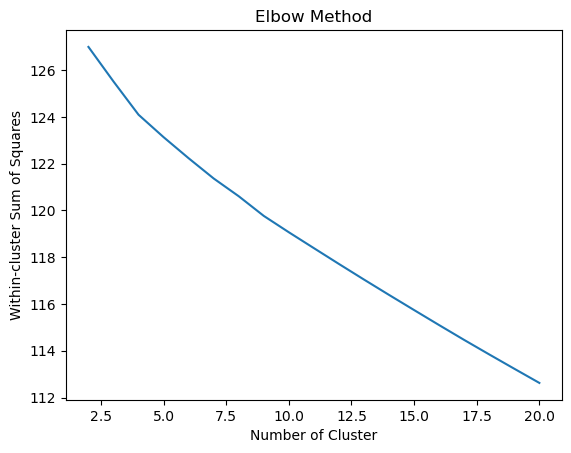

In [16]:
kmax = 20
ssq_list = []
for k in range(2, kmax+1):
    ssq = kmedoids.KMedoids(n_clusters=k,
                           random_state=0).fit(dtw_mat).inertia_
    ssq_list.append(ssq)
    
plt.plot(range(2, kmax+1), ssq_list)
plt.title("Elbow Method") 
plt.xlabel("Number of Cluster") 
plt.ylabel("Within-cluster Sum of Squares")

pd.DataFrame(ssq_list, columns = ['Difference in SS'], index = range(2,kmax+1)).diff()

,score
2,1.116520
3,1.109961
4,1.525495
5,2.260288
6,1.932617
7,1.697453
8,1.734864
9,2.281713
10,2.803442
11,2.618206


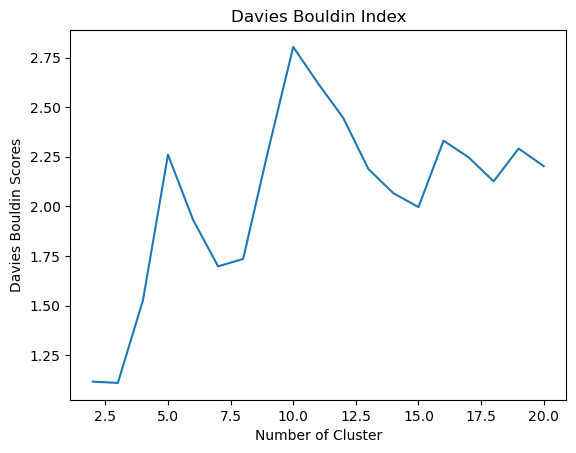

In [17]:
# Davies Bouldin score
db_scores = []
for k in range(2, kmax+1):
    score = kmedoids.KMedoids(n_clusters=k,
                              random_state=0).fit(dtw_mat).labels_
    db_scores.append(davies_bouldin_score(dtw_mat, score))
    
plt.plot(range(2, kmax+1), db_scores)
plt.title("Davies Bouldin Index") 
plt.xlabel("Number of Cluster") 
plt.ylabel("Davies Bouldin Scores")

pd.DataFrame(db_scores, columns=['score'], index=range(2,kmax+1))

In [18]:
# Get 4 clusters
num_clusters = 4
clusters_pred = kmedoids.KMedoids(n_clusters=num_clusters,
                                 random_state=0).fit_predict(dtw_mat)
clusters_pred_df = pd.DataFrame({'symbol': returns.columns,
                                 'cluster': clusters_pred})
clusters_pred_df

,symbol,cluster
0,A,1
1,AAP,3
2,AAPL,3
3,ABC,2
4,ABMD,1
...,...,...
388,XRAY,3
389,YUM,3
390,ZBH,3
391,ZBRA,3


In [19]:
clusters_pred_df.to_csv('clusters.csv')

In [20]:
# Prepare dataset for feeding into NN model

period = 7

def get_dataset(cluster, df, train_val_data=True):
    symbols = clusters_pred_df.loc[clusters_pred_df['cluster']==cluster, 'symbol']
    temp = df.loc[df.symbol.isin(symbols), :]
    if train_val_data:
        temp = temp.loc[~temp.index.isin(temp.index.unique()[-period:]), :]
    x, y = temp.loc[:, indicators].to_numpy(), temp.loc[:, 'Target'].to_numpy()
    return x, y

In [21]:
def create_early_stopping():
    return tf.keras.callbacks.EarlyStopping(monitor='val_mae',
                                           patience=3)

In [27]:
def plot_history(histories):
    fig, ax = plt.subplots(num_clusters, 2, figsize=(150,150))
    fig.tight_layout()
    metrics = ['mae', 'mse']
    for i in range(num_clusters):
        history = histories[i]
        for j in range(2):
            metric = metrics[j]
            ax[i,j].plot(history.history[f'{metric}'])
            ax[i,j].plot(history.history[f'val_{metric}'])
            ax[i,j].legend([f'train {metric}', f'val {metric}'], loc='upper left')
            ax[i,j].set_title(f'cluster_{i}')
            ax[i,j].figure.set_size_inches(30,30)

In [23]:
val_df = pd.concat(val_dic.values())
val_df

,Open,Close,symbol,industry,Close_norm,return,Close_norm_1,Close_norm_2,Close_norm_3,Close_norm_4,...,Close_norm_92,Close_norm_93,Close_norm_94,Close_norm_95,Close_norm_96,Close_norm_97,Close_norm_98,Close_norm_99,Close_shifted,Target
Date,,,,,,,,,,,,,,,,,,,,,
2015-01-02,41.180000,40.560001,A,Health Care,0.241930,-0.009325,0.374069,0.523597,0.509689,0.527075,...,0.562087,0.646659,0.703870,0.693919,0.460105,-0.027426,-0.236369,-0.345813,40.110001,-0.019097
2015-01-05,40.320000,39.799999,A,Health Care,-0.022352,-0.018916,0.241930,0.374069,0.523597,0.509689,...,0.475028,0.562087,0.646659,0.703870,0.693919,0.460105,-0.027426,-0.236369,39.549999,-0.018839
2015-01-06,39.810001,39.180000,A,Health Care,-0.237950,-0.015700,-0.022352,0.241930,0.374069,0.523597,...,0.499903,0.475028,0.562087,0.646659,0.703870,0.693919,0.460105,-0.027426,39.060001,-0.038209
2015-01-07,39.520000,39.700001,A,Health Care,-0.057126,0.013185,-0.237950,-0.022352,0.241930,0.374069,...,0.527264,0.499903,0.475028,0.562087,0.646659,0.703870,0.693919,0.460105,38.009998,-0.049453
2015-01-08,40.240002,40.889999,A,Health Care,0.356683,0.029534,-0.057126,-0.237950,-0.022352,0.241930,...,0.410356,0.527264,0.499903,0.475028,0.562087,0.646659,0.703870,0.693919,38.250000,-0.074878
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2015-12-24,27.629999,27.780001,ZION,Financials,-0.496000,0.003968,-0.540000,-0.744000,-0.900000,-0.924001,...,0.592000,0.440000,0.384000,0.648000,1.000000,0.680000,0.796000,0.888000,NaN,NaN
2015-12-28,27.629999,27.639999,ZION,Financials,-0.552000,-0.005052,-0.496000,-0.540000,-0.744000,-0.900000,...,0.543999,0.592000,0.440000,0.384000,0.648000,1.000000,0.680000,0.796000,NaN,NaN
2015-12-29,27.879999,27.809999,ZION,Financials,-0.484000,0.006132,-0.552000,-0.496000,-0.540000,-0.744000,...,0.632000,0.543999,0.592000,0.440000,0.384000,0.648000,1.000000,0.680000,NaN,NaN


In [25]:
# Train LSTM models for each cluster

histories = []
for i in range(num_clusters):
    train_x, train_y = get_dataset(i, train_df)
    val_x, val_y = get_dataset(i, val_df)
    
    tf.random.set_seed(0)
    inputs = layers.Input(shape=(100,), dtype=tf.float32)
    x = layers.Lambda(lambda x: tf.expand_dims(x, axis=2))(inputs)
    x = layers.LSTM(128, activation='relu', input_shape=(100,1))(x)
    x = layers.Dropout(0.2)(x)
    output = layers.Dense(1)(x)
    
    model = tf.keras.Model(inputs, output)
    model.compile(loss='mae',
                 optimizer='Adam',
                 metrics=['mae', 'mse'])
    
    history = model.fit(train_x,
             train_y,
             epochs=15,
             validation_data=(val_x, val_y),
             callbacks = [create_early_stopping()])
    
    histories.append(history)
    file_loc = f'{os.getcwd()}\cluster_{i}_pretrained_model'
    tf.keras.models.save_model(model, file_loc)

Epoch 1/15
4153/4153 [==============================] - 567s 136ms/step - loss: 0.0343 - mae: 0.0343 - mse: 0.0022 - val_loss: 0.0327 - val_mae: 0.0327 - val_mse: 0.0021
Epoch 2/15
4153/4153 [==============================] - 559s 135ms/step - loss: 0.0342 - mae: 0.0342 - mse: 0.0022 - val_loss: 0.0330 - val_mae: 0.0330 - val_mse: 0.0021
Epoch 3/15
4153/4153 [==============================] - 561s 135ms/step - loss: 0.0342 - mae: 0.0342 - mse: 0.0022 - val_loss: 0.0326 - val_mae: 0.0326 - val_mse: 0.0021
Epoch 4/15
4153/4153 [==============================] - 558s 134ms/step - loss: 0.0342 - mae: 0.0342 - mse: 0.0022 - val_loss: 0.0331 - val_mae: 0.0331 - val_mse: 0.0021
Epoch 5/15
4153/4153 [==============================] - 550s 132ms/step - loss: 0.0342 - mae: 0.0342 - mse: 0.0022 - val_loss: 0.0329 - val_mae: 0.0329 - val_mse: 0.0021
Epoch 6/15
4153/4153 [==============================] - 549s 132ms/step - loss: 0.0342 - mae: 0.0342 - mse: 0.0022 - val_loss: 0.0328 - val_mae: 0.032

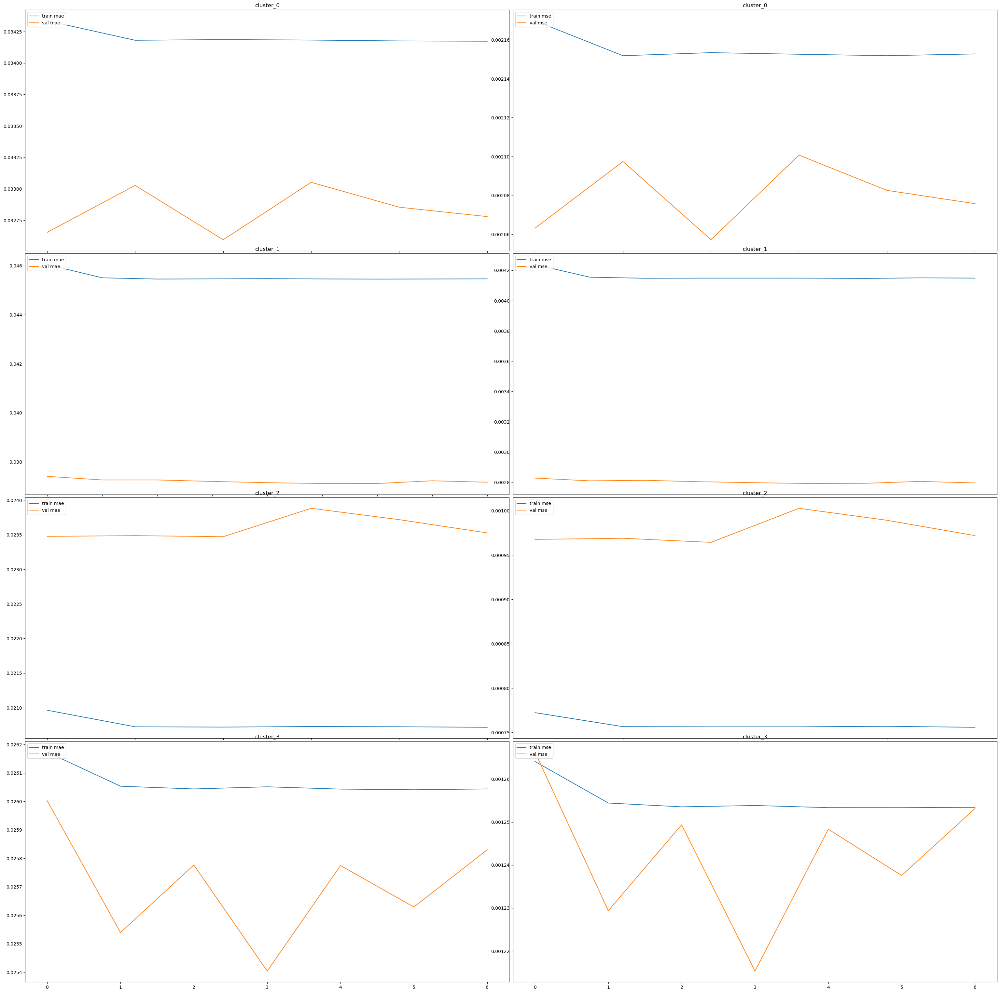

In [28]:
plot_history(histories)

In [37]:
fulltrain_dic = {}

for ticker in data.symbol.unique():
    train, val = train_dic[ticker], val_dic[ticker]
    temp = pd.concat([train, val])
    
    temp.loc[:, 'Close_shifted'] = temp.Close.shift(-6)
    temp.loc[:, 'Target'] = ((temp['Close_shifted']-temp['Open'])/temp['Open']).shift(-1)
    fulltrain_dic[ticker] = temp

In [38]:
# with open('fulltrain_dic.pkl', 'wb') as f:
#     pickle.dump(fulltrain_dic, f)

In [ ]:
# with open('fulltrain_dic.pkl', 'rb') as f:
#     fulltrain_dic = pickle.load(f)

In [39]:
fulltrain_df = pd.concat(fulltrain_dic.values())
fulltrain_df

,Open,Close,symbol,industry,Close_norm,return,Close_norm_1,Close_norm_2,Close_norm_3,Close_norm_4,...,Close_norm_93,Close_norm_94,Close_norm_95,Close_norm_96,Close_norm_97,Close_norm_98,Close_norm_99,Close_stand,Close_shifted,Target
Date,,,,,,,,,,,,,,,,,,,,,
2011-01-03,29.728184,29.957083,A,Health Care,0.994649,0.010803,0.934448,0.955852,0.969231,0.945150,...,-0.787291,-0.789966,-0.669565,-0.690970,-0.974582,-0.949164,-0.925084,-0.559328,30.715307,0.027149
2011-01-04,30.035765,29.678112,A,Health Care,0.942475,-0.009356,0.994649,0.934448,0.955852,0.969231,...,-0.867559,-0.787291,-0.789966,-0.669565,-0.690970,-0.974582,-0.949164,-0.609306,30.851215,0.041444
2011-01-05,29.513592,29.613733,A,Health Care,0.930434,-0.002172,0.942475,0.994649,0.934448,0.955852,...,-0.947826,-0.867559,-0.787291,-0.789966,-0.669565,-0.690970,-0.974582,-0.620840,30.736767,0.045685
2011-01-06,29.592276,29.670959,A,Health Care,0.941137,0.001931,0.930434,0.942475,0.994649,0.934448,...,-0.903679,-0.947826,-0.867559,-0.787291,-0.789966,-0.669565,-0.690970,-0.610588,30.944206,0.068160
2011-01-07,29.699572,29.771103,A,Health Care,0.959866,0.003369,0.941137,0.930434,0.942475,0.994649,...,-0.927759,-0.903679,-0.947826,-0.867559,-0.787291,-0.789966,-0.669565,-0.592647,31.723890,0.024632
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2015-12-24,27.629999,27.780001,ZION,Financials,-0.496000,0.003968,-0.540000,-0.744000,-0.900000,-0.924001,...,0.440000,0.384000,0.648000,1.000000,0.680000,0.796000,0.888000,NaN,NaN,NaN
2015-12-28,27.629999,27.639999,ZION,Financials,-0.552000,-0.005052,-0.496000,-0.540000,-0.744000,-0.900000,...,0.592000,0.440000,0.384000,0.648000,1.000000,0.680000,0.796000,NaN,NaN,NaN
2015-12-29,27.879999,27.809999,ZION,Financials,-0.484000,0.006132,-0.552000,-0.496000,-0.540000,-0.744000,...,0.543999,0.592000,0.440000,0.384000,0.648000,1.000000,0.680000,NaN,NaN,NaN


In [40]:
val_histories = []
epochs = [3, 5, 2, 3]

for i in range(num_clusters):
    fulltrain_x, fulltrain_y = get_dataset(i, fulltrain_df)
    
    tf.random.set_seed(0)
    inputs = layers.Input(shape=(100,), dtype=tf.float32)
    x = layers.Lambda(lambda x: tf.expand_dims(x, axis=2))(inputs)
    x = layers.LSTM(128, activation='relu')(x)
    x = layers.Dropout(0.2)(x)
    output = layers.Dense(1)(x)
    
    model = tf.keras.Model(inputs, output)
    model.compile(loss='mae',
                 optimizer='Adam',
                 metrics=['mae', 'mse'])
    
    history = model.fit(fulltrain_x,
             fulltrain_y,
             epochs=epochs[i])
    
    val_histories.append(history)
    file_loc = f'{os.getcwd()}\cluster_{i}_validated_model'
    tf.keras.models.save_model(model, file_loc)

Epoch 1/3
4813/4813 [==============================] - 518s 107ms/step - loss: 0.0335 - mae: 0.0335 - mse: 0.0021
Epoch 2/3
4813/4813 [==============================] - 503s 104ms/step - loss: 0.0334 - mae: 0.0334 - mse: 0.0021
Epoch 3/3
4813/4813 [==============================] - 504s 105ms/step - loss: 0.0334 - mae: 0.0334 - mse: 0.0021
INFO:tensorflow:Assets written to: C:\Users\kmlee\Desktop\Quant-Projects\SP500\DTW_KMedoids_LSTM_strategy\cluster_0_validated_model\assets
Epoch 1/5
1339/1339 [==============================] - 139s 102ms/step - loss: 0.0444 - mae: 0.0444 - mse: 0.0040
Epoch 2/5
1339/1339 [==============================] - 136s 102ms/step - loss: 0.0440 - mae: 0.0440 - mse: 0.0039
Epoch 3/5
1339/1339 [==============================] - 137s 102ms/step - loss: 0.0439 - mae: 0.0439 - mse: 0.0039
Epoch 4/5
1339/1339 [==============================] - 134s 100ms/step - loss: 0.0439 - mae: 0.0439 - mse: 0.0039
Epoch 5/5
1339/1339 [==============================] - 135s 101

In [41]:
test_df = pd.concat(test_dic.values())
test_df

,Open,Close,symbol,industry,Close_norm,return,Close_norm_1,Close_norm_2,Close_norm_3,Close_norm_4,...,Close_norm_92,Close_norm_93,Close_norm_94,Close_norm_95,Close_norm_96,Close_norm_97,Close_norm_98,Close_norm_99,Close_shifted,Target
Date,,,,,,,,,,,,,,,,,,,,,
2016-01-04,41.060001,40.689999,A,Health Care,0.628476,-0.027153,0.877642,0.957730,1.000000,0.870967,...,-0.363737,-0.078977,0.119022,0.256952,0.212458,0.174639,0.154617,0.228031,38.189999,-0.095016
2016-01-05,40.730000,40.549999,A,Health Care,0.597330,-0.003447,0.628476,0.877642,0.957730,1.000000,...,-0.708565,-0.363737,-0.078977,0.119022,0.256952,0.212458,0.174639,0.154617,36.860001,-0.065358
2016-01-06,40.240002,40.730000,A,Health Care,0.637375,0.004429,0.597330,0.628476,0.877642,0.957730,...,-0.779755,-0.708565,-0.363737,-0.078977,0.119022,0.256952,0.212458,0.174639,37.610001,-0.075486
2016-01-07,40.139999,39.000000,A,Health Care,0.252503,-0.043403,0.637375,0.597330,0.628476,0.877642,...,-0.499444,-0.779755,-0.708565,-0.363737,-0.078977,0.119022,0.256952,0.212458,37.110001,-0.051504
2016-01-08,39.220001,38.590000,A,Health Care,0.161290,-0.010568,0.252503,0.637375,0.597330,0.628476,...,-0.272525,-0.499444,-0.779755,-0.708565,-0.363737,-0.078977,0.119022,0.256952,37.200001,-0.037458
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-12-24,43.619999,43.340000,ZION,Financials,0.913924,-0.003915,0.935443,0.749367,0.798734,0.627848,...,-0.206329,-0.235443,-0.181013,-0.092405,-0.179747,-0.294937,-0.449367,-0.386076,NaN,NaN
2020-12-28,43.660000,43.360001,ZION,Financials,0.916456,0.000461,0.913924,0.935443,0.749367,0.798734,...,-0.283544,-0.206329,-0.235443,-0.181013,-0.092405,-0.179747,-0.294937,-0.449367,NaN,NaN
2020-12-29,43.389999,42.770000,ZION,Financials,0.841772,-0.013700,0.916456,0.913924,0.935443,0.749367,...,-0.427848,-0.283544,-0.206329,-0.235443,-0.181013,-0.092405,-0.179747,-0.294937,NaN,NaN


In [42]:
preds = []

for i in range(num_clusters):
    symbols = clusters_pred_df.loc[clusters_pred_df.cluster==i, 'symbol']
    tf.keras.backend.clear_session()
    model = tf.keras.models.load_model(f'{os.getcwd()}\cluster_{i}_validated_model')
    temp = test_df.loc[test_df.symbol.isin(symbols), :]
    testx = temp.loc[:, indicators].to_numpy()
    temp.loc[:, 'prediction'] = model.predict(testx)[:, 0]
    preds.append(temp)

5233/5233 [==============================] - 249s 48ms/step


C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1643936785.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'prediction'] = model.predict(testx)[:, 0]


1456/1456 [==============================] - 62s 42ms/step


C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1643936785.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'prediction'] = model.predict(testx)[:, 0]


3187/3187 [==============================] - 138s 43ms/step


C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1643936785.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'prediction'] = model.predict(testx)[:, 0]


5587/5587 [==============================] - 243s 44ms/step


C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1643936785.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'prediction'] = model.predict(testx)[:, 0]


In [45]:
preds_df = pd.concat(preds)
preds_df = preds_df.sort_values(['symbol', 'Date'])
preds_df

,Open,Close,symbol,industry,Close_norm,return,Close_norm_1,Close_norm_2,Close_norm_3,Close_norm_4,...,Close_norm_93,Close_norm_94,Close_norm_95,Close_norm_96,Close_norm_97,Close_norm_98,Close_norm_99,Close_shifted,Target,prediction
Date,,,,,,,,,,,,,,,,,,,,,
2016-01-04,41.060001,40.689999,A,Health Care,0.628476,-0.027153,0.877642,0.957730,1.000000,0.870967,...,-0.078977,0.119022,0.256952,0.212458,0.174639,0.154617,0.228031,38.189999,-0.095016,0.009220
2016-01-05,40.730000,40.549999,A,Health Care,0.597330,-0.003447,0.628476,0.877642,0.957730,1.000000,...,-0.363737,-0.078977,0.119022,0.256952,0.212458,0.174639,0.154617,36.860001,-0.065358,0.009099
2016-01-06,40.240002,40.730000,A,Health Care,0.637375,0.004429,0.597330,0.628476,0.877642,0.957730,...,-0.708565,-0.363737,-0.078977,0.119022,0.256952,0.212458,0.174639,37.610001,-0.075486,0.009040
2016-01-07,40.139999,39.000000,A,Health Care,0.252503,-0.043403,0.637375,0.597330,0.628476,0.877642,...,-0.779755,-0.708565,-0.363737,-0.078977,0.119022,0.256952,0.212458,37.110001,-0.051504,0.008918
2016-01-08,39.220001,38.590000,A,Health Care,0.161290,-0.010568,0.252503,0.637375,0.597330,0.628476,...,-0.499444,-0.779755,-0.708565,-0.363737,-0.078977,0.119022,0.256952,37.200001,-0.037458,0.008670
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-12-24,43.619999,43.340000,ZION,Financials,0.913924,-0.003915,0.935443,0.749367,0.798734,0.627848,...,-0.235443,-0.181013,-0.092405,-0.179747,-0.294937,-0.449367,-0.386076,NaN,NaN,0.007677
2020-12-28,43.660000,43.360001,ZION,Financials,0.916456,0.000461,0.913924,0.935443,0.749367,0.798734,...,-0.206329,-0.235443,-0.181013,-0.092405,-0.179747,-0.294937,-0.449367,NaN,NaN,0.007766
2020-12-29,43.389999,42.770000,ZION,Financials,0.841772,-0.013700,0.916456,0.913924,0.935443,0.749367,...,-0.283544,-0.206329,-0.235443,-0.181013,-0.092405,-0.179747,-0.294937,NaN,NaN,0.007928


In [46]:
period = 7
port_size = 20

for i in range(len(test_df.index.unique())):
    date = list(test_df.index.unique())[i]
    temp = preds_df.loc[preds_df.index==date, :]
    top_df = temp.sort_values(['prediction'], ascending=False).head(port_size)
    if i%period == 0:
        temp.loc[:, 'position'] = np.where(temp.symbol.isin(top_df['symbol']), 1, 0)
    else:
        temp.loc[:, 'position'] = [0]*len(temp)
    temp = temp.sort_values(['symbol'])
    preds_df.loc[preds_df.index == date, 'position'] = temp.loc[:, 'position']
    
preds_df

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1041678129.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'position'] = np.where(temp.symbol.isin(top_df['symbol']), 1, 0)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1041678129.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'position'] = [0]*len(temp)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1041678129.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using

,Open,Close,symbol,industry,Close_norm,return,Close_norm_1,Close_norm_2,Close_norm_3,Close_norm_4,...,Close_norm_94,Close_norm_95,Close_norm_96,Close_norm_97,Close_norm_98,Close_norm_99,Close_shifted,Target,prediction,position
Date,,,,,,,,,,,,,,,,,,,,,
2016-01-04,41.060001,40.689999,A,Health Care,0.628476,-0.027153,0.877642,0.957730,1.000000,0.870967,...,0.119022,0.256952,0.212458,0.174639,0.154617,0.228031,38.189999,-0.095016,0.009220,0.0
2016-01-05,40.730000,40.549999,A,Health Care,0.597330,-0.003447,0.628476,0.877642,0.957730,1.000000,...,-0.078977,0.119022,0.256952,0.212458,0.174639,0.154617,36.860001,-0.065358,0.009099,0.0
2016-01-06,40.240002,40.730000,A,Health Care,0.637375,0.004429,0.597330,0.628476,0.877642,0.957730,...,-0.363737,-0.078977,0.119022,0.256952,0.212458,0.174639,37.610001,-0.075486,0.009040,0.0
2016-01-07,40.139999,39.000000,A,Health Care,0.252503,-0.043403,0.637375,0.597330,0.628476,0.877642,...,-0.708565,-0.363737,-0.078977,0.119022,0.256952,0.212458,37.110001,-0.051504,0.008918,0.0
2016-01-08,39.220001,38.590000,A,Health Care,0.161290,-0.010568,0.252503,0.637375,0.597330,0.628476,...,-0.779755,-0.708565,-0.363737,-0.078977,0.119022,0.256952,37.200001,-0.037458,0.008670,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-12-24,43.619999,43.340000,ZION,Financials,0.913924,-0.003915,0.935443,0.749367,0.798734,0.627848,...,-0.181013,-0.092405,-0.179747,-0.294937,-0.449367,-0.386076,NaN,NaN,0.007677,0.0
2020-12-28,43.660000,43.360001,ZION,Financials,0.916456,0.000461,0.913924,0.935443,0.749367,0.798734,...,-0.235443,-0.181013,-0.092405,-0.179747,-0.294937,-0.449367,NaN,NaN,0.007766,0.0
2020-12-29,43.389999,42.770000,ZION,Financials,0.841772,-0.013700,0.916456,0.913924,0.935443,0.749367,...,-0.206329,-0.235443,-0.181013,-0.092405,-0.179747,-0.294937,NaN,NaN,0.007928,0.0


In [48]:
preds_df.to_csv('preds.csv')

In [49]:
def get_pnl(x):
    if x['position'].sum() > 0:
        return ((x['Target'])*x['position']).sum()/port_size + 1
    return 1

In [50]:
def strategy_return(preds_df):
    strategies = pd.DataFrame()
    strategies['avg return'] = preds_df.groupby('Date').apply(get_pnl).shift(7).fillna(1)
    strategies['strategy'] = np.log(strategies['avg return'])
    strategies['cumstrategy'] = strategies['strategy'].cumsum().apply(np.exp)
    return strategies

In [51]:
test_preds = strategy_return(preds_df)
test_preds

,avg return,strategy,cumstrategy
Date,,,
2016-01-04,1.0,0.0,1.000000
2016-01-05,1.0,0.0,1.000000
2016-01-06,1.0,0.0,1.000000
2016-01-07,1.0,0.0,1.000000
2016-01-08,1.0,0.0,1.000000
...,...,...,...
2020-12-24,1.0,0.0,2.411927
2020-12-28,1.0,0.0,2.411927
2020-12-29,1.0,0.0,2.411927


In [53]:
mae_df = preds_df.groupby('symbol').apply(lambda x: mean_absolute_error(x['Target'].dropna(), x.iloc[:-7, :]['prediction']))
rmse_df = preds_df.groupby('symbol').apply(lambda x: np.sqrt(mean_squared_error(x['Target'].dropna(), x.iloc[:-7, :]['prediction'])))
mae_df.mean(), rmse_df.mean()

(0.03382509899177518, 0.048920157116961197)

Text(0.5, 1.0, 'Top 10 highest tickers RMSE')

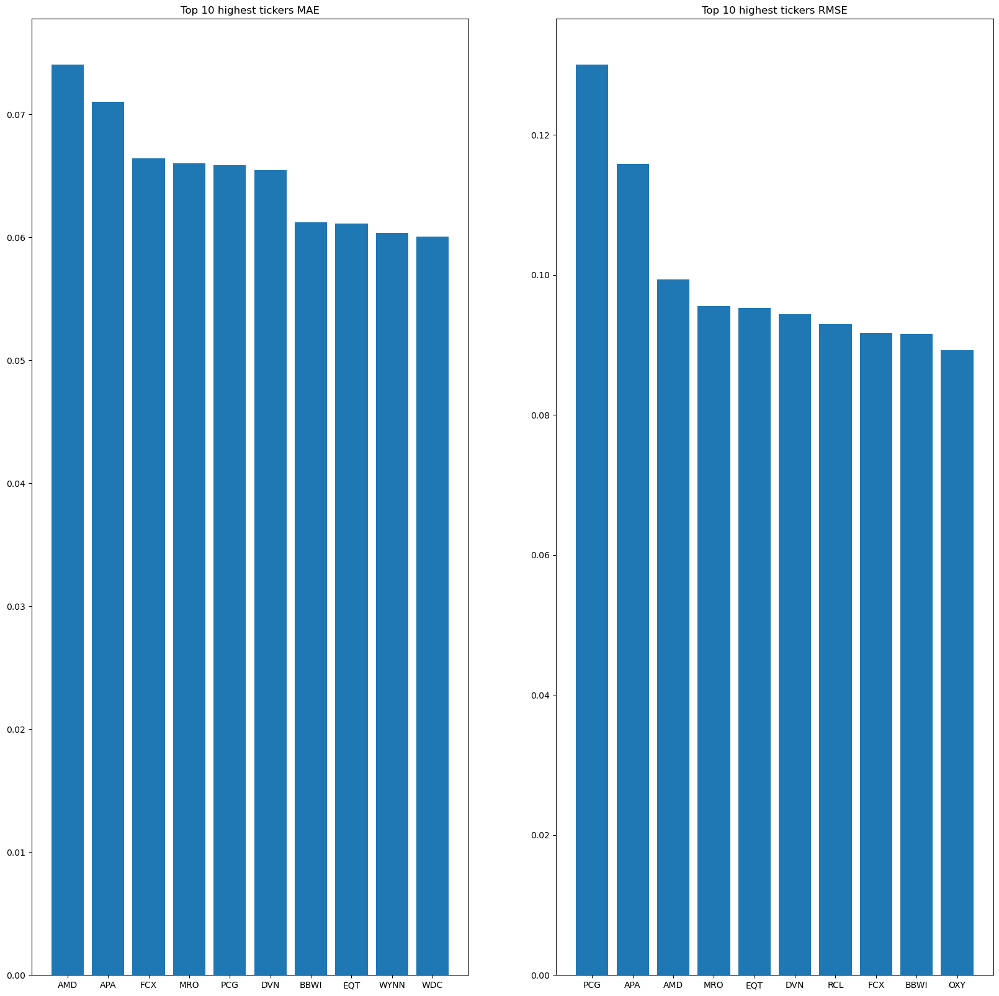

In [54]:
fig, ax = plt.subplots(1, 2, figsize=(20,20))
ax[0].bar(mae_df.sort_values(ascending=False).head(10).index, mae_df.sort_values(ascending=False).head(10))
ax[0].set_title('Top 10 highest tickers MAE')
ax[1].bar(rmse_df.sort_values(ascending=False).head(10).index, rmse_df.sort_values(ascending=False).head(10))
ax[1].set_title('Top 10 highest tickers RMSE')

In [55]:
def plot_returns(benchmark, strategy, title):
    plt.figure(figsize=(20, 12))
    plt.plot(pd.to_datetime(strategy.index).date, strategy.cumstrategy, label='Model')
    plt.plot(benchmark.index, benchmark['cumreturn'], color='red', label='SP500 Buy & Hold')
    plt.title(title)
    plt.gca().grid(True)
    plt.legend()

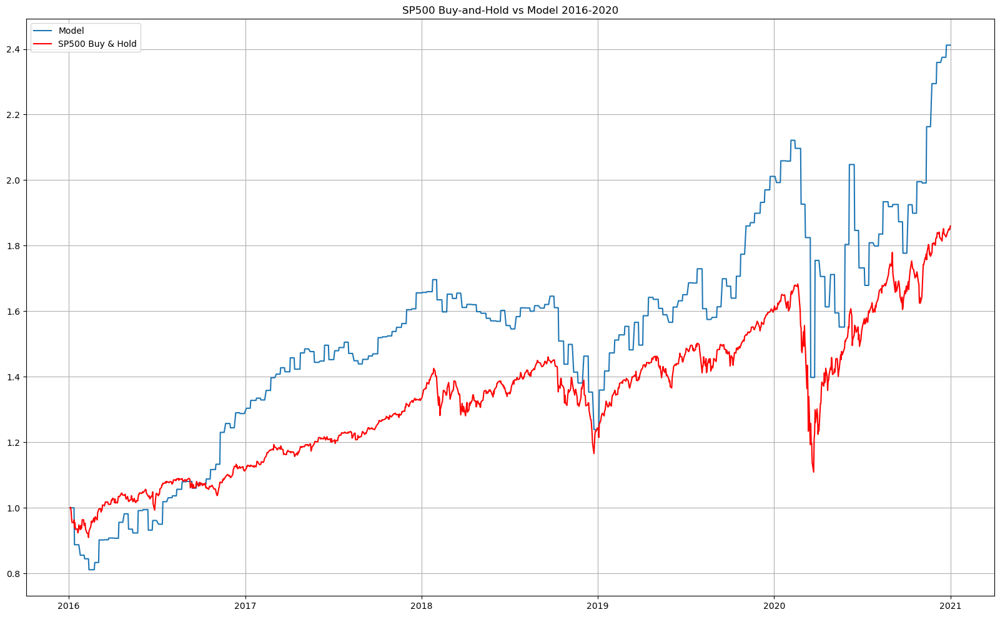

In [57]:
plot_returns(sp500.loc[sp500.index < '2021-01-01', :], test_preds, 'SP500 Buy-and-Hold vs Model 2016-2020')

In [58]:
sp500_weekly = sp500.loc[sp500.index < '2021-01-01', :]
sp500_weekly['Close shifted'] = sp500_weekly.Close.shift(-6)
sp500_weekly['Target'] = ((sp500_weekly['Close shifted']-sp500_weekly.Open)/sp500_weekly.Open).shift(-1)
sp500_weekly_return = []
for i in range(len(sp500_weekly)):
    if i%period == 0:
        sp500_weekly_return.append(sp500_weekly.iloc[i]['Target'])
    else:
        sp500_weekly_return.append(0)
temp_df = pd.DataFrame({'return': sp500_weekly_return}).shift(7)
temp_df =  temp_df.loc[temp_df['return'] != 0, 'return'].dropna()
sp500_sharpe = temp_df.mean()/temp_df.std()
sp500_sharpe

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1287369743.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sp500_weekly['Close shifted'] = sp500_weekly.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1287369743.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sp500_weekly['Target'] = ((sp500_weekly['Close shifted']-sp500_weekly.Open)/sp500_weekly.Open).shift(-1)


0.16723321200780666

In [60]:
strategy_weekly_return = test_preds.loc[test_preds['avg return'] != 1, 'avg return'] - 1
strategy_sharpe = strategy_weekly_return.mean()/strategy_weekly_return.std()
strategy_sharpe

0.12942716088801015

In [62]:
test_ext_dic = {}

for ticker in data.symbol.unique():
    temp = data.loc[data.symbol == ticker, :]
    temp.loc[:, 'Close_norm'] = temp['Close']
    temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
    for i in range(1, lag):
        temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
    tempT = temp.loc[:, indicators].transpose()
    normalizer = MinMaxScaler(feature_range=(-1,1))
    normT = normalizer.fit_transform(tempT)
    temp.loc[:, indicators] = normT.transpose()
    temp = temp.loc[temp.index >= '2016-01-01', :]
    
    temp.loc[:, 'Close_shifted'] = temp.Close.shift(-6)
    temp.loc[:, 'Target'] = ((temp['Close_shifted']-temp['Open'])/temp['Open']).shift(-1)
    test_ext_dic[ticker] = temp

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_ind

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_ind

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\1532127212.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()


In [64]:
# with open('test_ext_dic.pkl', 'wb') as f:
#     pickle.dump(test_ext_dic, f)

In [67]:
test_ext_df = pd.concat(test_ext_dic.values())
test_ext_df_cut = test_ext_df.loc[test_ext_df.index >= '2021-01-01', :]
test_ext_df_cut

,Open,Close,symbol,industry,Close_norm,return,Close_norm_1,Close_norm_2,Close_norm_3,Close_norm_4,...,Close_norm_92,Close_norm_93,Close_norm_94,Close_norm_95,Close_norm_96,Close_norm_97,Close_norm_98,Close_norm_99,Close_shifted,Target
Date,,,,,,,,,,,,,,,,,,,,,
2021-01-04,118.940002,118.639999,A,Health Care,0.945364,0.001265,0.932947,0.841887,0.828642,0.878311,...,-0.738410,-0.781457,-0.766556,-0.774834,-0.803808,-0.815397,-0.699504,-0.793874,126.970001,0.071742
2021-01-05,118.480003,119.610001,A,Health Care,1.000000,0.008143,0.920719,0.908459,0.818553,0.805476,...,-0.798938,-0.741724,-0.784226,-0.769514,-0.777687,-0.806293,-0.817736,-0.703310,126.980003,0.061842
2021-01-06,118.690002,122.889999,A,Health Care,1.000000,0.027053,0.763604,0.693694,0.682883,0.603604,...,-0.769370,-0.822703,-0.772252,-0.809730,-0.796757,-0.803964,-0.829189,-0.839279,126.029999,0.015121
2021-01-07,124.330002,126.160004,A,Health Care,1.000000,0.026261,0.789168,0.577692,0.515151,0.505480,...,-0.729852,-0.793682,-0.841393,-0.796260,-0.829787,-0.818182,-0.824629,-0.847195,126.209999,0.006799
2021-01-08,126.489998,127.059998,A,Health Care,1.000000,0.007108,0.943609,0.738722,0.533208,0.472431,...,-0.756892,-0.737469,-0.799499,-0.845865,-0.802005,-0.834586,-0.823308,-0.829574,127.349998,0.013128
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-10-24,48.320000,49.779999,ZION,Financials,-0.553120,0.040169,-0.883643,-1.000000,-0.647555,-0.182125,...,-0.332209,-0.045531,0.288364,0.585160,0.730185,0.645868,0.586846,0.681281,NaN,NaN
2022-10-25,47.720001,51.509998,ZION,Financials,-0.261383,0.034163,-0.553120,-0.883643,-1.000000,-0.647555,...,-0.209107,-0.332209,-0.045531,0.288364,0.585160,0.730185,0.645868,0.586846,NaN,NaN
2022-10-26,51.040001,50.400002,ZION,Financials,-0.448567,-0.021785,-0.261383,-0.553120,-0.883643,-1.000000,...,0.010118,-0.209107,-0.332209,-0.045531,0.288364,0.585160,0.730185,0.645868,NaN,NaN


In [68]:
preds_ext = []

for i in range(num_clusters):
    symbols = clusters_pred_df.loc[clusters_pred_df.cluster==i, 'symbol']
    tf.keras.backend.clear_session()
    model = tf.keras.models.load_model(f'{os.getcwd()}\cluster_{i}_validated_model')
    temp = test_ext_df_cut.loc[test_ext_df_cut.symbol.isin(symbols), :]
    testx = temp.loc[:, indicators].to_numpy()
    temp.loc[:, 'prediction'] = model.predict(testx)[:, 0]
    preds_ext.append(temp)

1912/1912 [==============================] - 92s 48ms/step


C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\17185579.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'prediction'] = model.predict(testx)[:, 0]


532/532 [==============================] - 23s 42ms/step


C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\17185579.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'prediction'] = model.predict(testx)[:, 0]


1165/1165 [==============================] - 57s 49ms/step


C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\17185579.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'prediction'] = model.predict(testx)[:, 0]


2042/2042 [==============================] - 96s 47ms/step


C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\17185579.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'prediction'] = model.predict(testx)[:, 0]


In [115]:
preds_ext_df = pd.concat(preds_ext)
preds_ext_df = preds_ext_df.sort_values(['symbol', 'Date'])
preds_ext_df

,Open,Close,symbol,industry,Close_norm,return,Close_norm_1,Close_norm_2,Close_norm_3,Close_norm_4,...,Close_norm_93,Close_norm_94,Close_norm_95,Close_norm_96,Close_norm_97,Close_norm_98,Close_norm_99,Close_shifted,Target,prediction
Date,,,,,,,,,,,,,,,,,,,,,
2021-01-04,118.940002,118.639999,A,Health Care,0.945364,0.001265,0.932947,0.841887,0.828642,0.878311,...,-0.781457,-0.766556,-0.774834,-0.803808,-0.815397,-0.699504,-0.793874,126.970001,0.071742,0.007342
2021-01-05,118.480003,119.610001,A,Health Care,1.000000,0.008143,0.920719,0.908459,0.818553,0.805476,...,-0.741724,-0.784226,-0.769514,-0.777687,-0.806293,-0.817736,-0.703310,126.980003,0.061842,0.007342
2021-01-06,118.690002,122.889999,A,Health Care,1.000000,0.027053,0.763604,0.693694,0.682883,0.603604,...,-0.822703,-0.772252,-0.809730,-0.796757,-0.803964,-0.829189,-0.839279,126.029999,0.015121,0.007340
2021-01-07,124.330002,126.160004,A,Health Care,1.000000,0.026261,0.789168,0.577692,0.515151,0.505480,...,-0.793682,-0.841393,-0.796260,-0.829787,-0.818182,-0.824629,-0.847195,126.209999,0.006799,0.007338
2021-01-08,126.489998,127.059998,A,Health Care,1.000000,0.007108,0.943609,0.738722,0.533208,0.472431,...,-0.737469,-0.799499,-0.845865,-0.802005,-0.834586,-0.823308,-0.829574,127.349998,0.013128,0.007339
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-10-24,48.320000,49.779999,ZION,Financials,-0.553120,0.040169,-0.883643,-1.000000,-0.647555,-0.182125,...,-0.045531,0.288364,0.585160,0.730185,0.645868,0.586846,0.681281,NaN,NaN,0.010724
2022-10-25,47.720001,51.509998,ZION,Financials,-0.261383,0.034163,-0.553120,-0.883643,-1.000000,-0.647555,...,-0.332209,-0.045531,0.288364,0.585160,0.730185,0.645868,0.586846,NaN,NaN,0.010505
2022-10-26,51.040001,50.400002,ZION,Financials,-0.448567,-0.021785,-0.261383,-0.553120,-0.883643,-1.000000,...,-0.209107,-0.332209,-0.045531,0.288364,0.585160,0.730185,0.645868,NaN,NaN,0.010396


In [116]:
for i in range(len(test_ext_df_cut.index.unique())):
    date = list(test_ext_df_cut.index.unique())[i]
    index = list(test_ext_df.index.unique()).index(date)
    temp = preds_ext_df.loc[preds_ext_df.index==date, :]
    top_df = temp.sort_values(['prediction'], ascending=False).head(port_size)
    if index%period == 0:
        temp.loc[:, 'position'] = np.where(temp.symbol.isin(top_df['symbol']), 1, 0)
    else:
        temp.loc[:, 'position'] = [0]*len(temp)
    temp = temp.sort_values(['symbol'])
    preds_ext_df.loc[preds_ext_df.index == date, 'position'] = temp.loc[:, 'position']
    
preds_ext_df

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\984142702.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'position'] = [0]*len(temp)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\984142702.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'position'] = np.where(temp.symbol.isin(top_df['symbol']), 1, 0)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\984142702.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .lo

,Open,Close,symbol,industry,Close_norm,return,Close_norm_1,Close_norm_2,Close_norm_3,Close_norm_4,...,Close_norm_94,Close_norm_95,Close_norm_96,Close_norm_97,Close_norm_98,Close_norm_99,Close_shifted,Target,prediction,position
Date,,,,,,,,,,,,,,,,,,,,,
2021-01-04,118.940002,118.639999,A,Health Care,0.945364,0.001265,0.932947,0.841887,0.828642,0.878311,...,-0.766556,-0.774834,-0.803808,-0.815397,-0.699504,-0.793874,126.970001,0.071742,0.007342,0.0
2021-01-05,118.480003,119.610001,A,Health Care,1.000000,0.008143,0.920719,0.908459,0.818553,0.805476,...,-0.784226,-0.769514,-0.777687,-0.806293,-0.817736,-0.703310,126.980003,0.061842,0.007342,0.0
2021-01-06,118.690002,122.889999,A,Health Care,1.000000,0.027053,0.763604,0.693694,0.682883,0.603604,...,-0.772252,-0.809730,-0.796757,-0.803964,-0.829189,-0.839279,126.029999,0.015121,0.007340,0.0
2021-01-07,124.330002,126.160004,A,Health Care,1.000000,0.026261,0.789168,0.577692,0.515151,0.505480,...,-0.841393,-0.796260,-0.829787,-0.818182,-0.824629,-0.847195,126.209999,0.006799,0.007338,0.0
2021-01-08,126.489998,127.059998,A,Health Care,1.000000,0.007108,0.943609,0.738722,0.533208,0.472431,...,-0.799499,-0.845865,-0.802005,-0.834586,-0.823308,-0.829574,127.349998,0.013128,0.007339,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-10-24,48.320000,49.779999,ZION,Financials,-0.553120,0.040169,-0.883643,-1.000000,-0.647555,-0.182125,...,0.288364,0.585160,0.730185,0.645868,0.586846,0.681281,NaN,NaN,0.010724,0.0
2022-10-25,47.720001,51.509998,ZION,Financials,-0.261383,0.034163,-0.553120,-0.883643,-1.000000,-0.647555,...,-0.045531,0.288364,0.585160,0.730185,0.645868,0.586846,NaN,NaN,0.010505,1.0
2022-10-26,51.040001,50.400002,ZION,Financials,-0.448567,-0.021785,-0.261383,-0.553120,-0.883643,-1.000000,...,-0.332209,-0.045531,0.288364,0.585160,0.730185,0.645868,NaN,NaN,0.010396,0.0


In [117]:
preds_ext_df = pd.concat([preds_df, preds_ext_df])
preds_ext_df

,Open,Close,symbol,industry,Close_norm,return,Close_norm_1,Close_norm_2,Close_norm_3,Close_norm_4,...,Close_norm_94,Close_norm_95,Close_norm_96,Close_norm_97,Close_norm_98,Close_norm_99,Close_shifted,Target,prediction,position
Date,,,,,,,,,,,,,,,,,,,,,
2016-01-04,41.060001,40.689999,A,Health Care,0.628476,-0.027153,0.877642,0.957730,1.000000,0.870967,...,0.119022,0.256952,0.212458,0.174639,0.154617,0.228031,38.189999,-0.095016,0.009220,0.0
2016-01-05,40.730000,40.549999,A,Health Care,0.597330,-0.003447,0.628476,0.877642,0.957730,1.000000,...,-0.078977,0.119022,0.256952,0.212458,0.174639,0.154617,36.860001,-0.065358,0.009099,0.0
2016-01-06,40.240002,40.730000,A,Health Care,0.637375,0.004429,0.597330,0.628476,0.877642,0.957730,...,-0.363737,-0.078977,0.119022,0.256952,0.212458,0.174639,37.610001,-0.075486,0.009040,0.0
2016-01-07,40.139999,39.000000,A,Health Care,0.252503,-0.043403,0.637375,0.597330,0.628476,0.877642,...,-0.708565,-0.363737,-0.078977,0.119022,0.256952,0.212458,37.110001,-0.051504,0.008918,0.0
2016-01-08,39.220001,38.590000,A,Health Care,0.161290,-0.010568,0.252503,0.637375,0.597330,0.628476,...,-0.779755,-0.708565,-0.363737,-0.078977,0.119022,0.256952,37.200001,-0.037458,0.008670,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-10-24,48.320000,49.779999,ZION,Financials,-0.553120,0.040169,-0.883643,-1.000000,-0.647555,-0.182125,...,0.288364,0.585160,0.730185,0.645868,0.586846,0.681281,NaN,NaN,0.010724,0.0
2022-10-25,47.720001,51.509998,ZION,Financials,-0.261383,0.034163,-0.553120,-0.883643,-1.000000,-0.647555,...,-0.045531,0.288364,0.585160,0.730185,0.645868,0.586846,NaN,NaN,0.010505,1.0
2022-10-26,51.040001,50.400002,ZION,Financials,-0.448567,-0.021785,-0.261383,-0.553120,-0.883643,-1.000000,...,-0.332209,-0.045531,0.288364,0.585160,0.730185,0.645868,NaN,NaN,0.010396,0.0


In [118]:
test_ext_strategies = strategy_return(preds_ext_df)
test_ext_strategies

,avg return,strategy,cumstrategy
Date,,,
2016-01-04,1.000000,0.000000,1.000000
2016-01-05,1.000000,0.000000,1.000000
2016-01-06,1.000000,0.000000,1.000000
2016-01-07,1.000000,0.000000,1.000000
2016-01-08,1.000000,0.000000,1.000000
...,...,...,...
2022-10-24,1.000000,0.000000,2.535811
2022-10-25,1.056046,0.054532,2.677934
2022-10-26,1.000000,0.000000,2.677934


In [144]:
for ticker in preds_ext_df.symbol.unique():
    temp = preds_ext_df.loc[preds_ext_df.symbol==ticker, :]
    temp.loc[:, 'Close_shifted'] = temp.Close.shift(-6)
    temp.loc[:, 'Target'] = ((temp['Close_shifted']-temp['Open'])/temp['Open']).shift(-1)
    preds_ext_df.loc[preds_ext_df.symbol==ticker, 'Target'] = temp.Target

C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\2147827014.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_shifted'] = temp.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_43576\2147827014.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Target'] = ((temp['Close_shifted']-temp['Open'])/temp['Open']).shift(-1)


In [145]:
mae_df = preds_ext_df.groupby('symbol').apply(lambda x: mean_absolute_error(x.iloc[:-7, :]['Target'], x.iloc[:-7, :]['prediction']))
rmse_df = preds_ext_df.groupby('symbol').apply(lambda x: np.sqrt(mean_squared_error(x.iloc[:-7, :]['Target'], x.iloc[:-7, :]['prediction'])))
mae_df.mean(), rmse_df.mean()

(0.03485955132851095, 0.049015634939391685)

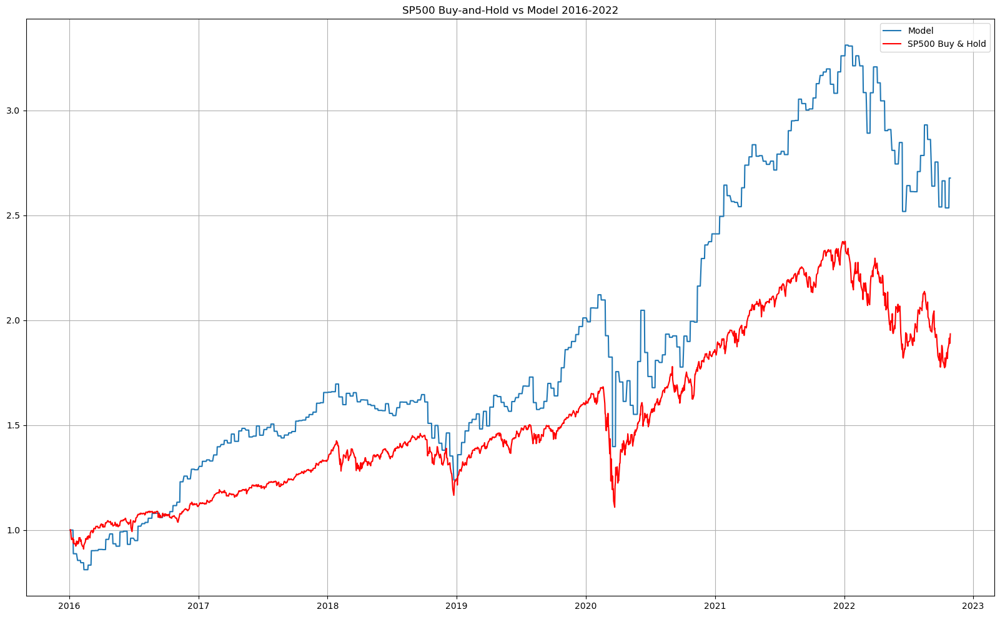

In [95]:
plot_returns(sp500, test_ext_strategies, 'SP500 Buy-and-Hold vs Model 2016-2022')

In [110]:
sp500_weekly = sp500
sp500_weekly['Close shifted'] = sp500_weekly.Close.shift(-6)
sp500_weekly['Target'] = ((sp500_weekly['Close shifted']-sp500_weekly.Open)/sp500_weekly.Open).shift(-1)
sp500_weekly_return = []
for i in range(len(sp500_weekly)):
    if i%period == 0:
        sp500_weekly_return.append(sp500_weekly.iloc[i]['Target'])
    else:
        sp500_weekly_return.append(0)
temp_df = pd.DataFrame({'return': sp500_weekly_return}).shift(7)
temp_df =  temp_df.loc[temp_df['return'] != 0, 'return'].dropna()
sp500_sharpe = temp_df.mean()/temp_df.std()
sp500_sharpe

0.13379370617302544

In [112]:
strategy_weekly_return = test_ext_strategies.loc[test_ext_strategies['avg return'] != 1, 'avg return'] - 1
strategy_sharpe = strategy_weekly_return.mean()/strategy_weekly_return.std()
strategy_sharpe

0.11448898234939496